In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import numpy as np
import cv2
import imutils
import random
import mahotas

from IPython.display import display, Image
from matplotlib import pyplot as plt

%matplotlib inline

In [5]:
base_path = '/Users/sam/All-Program/App-DataSet/Kaggle-Challenges/CIFAR-10/'

airplaneDatapath = base_path + "trainDataAirplane/"
autoDatapath = base_path + "trainDataAuto/"
birdDatapath = base_path + "trainDataBird/"
catDatapath = base_path + "trainDataCat/"
deerDatapath = base_path + "trainDataDeer/"
dogDatapath = base_path + "trainDataDog/"
frogDatapath = base_path + "trainDataFrog/"
horseDatapath = base_path + "trainDataHorse/"
shipDatapath = base_path + "trainDataShip/"
truckDatapath = base_path + "trainDataTruck/"

dirDict = [airplaneDatapath, autoDatapath, birdDatapath, catDatapath, deerDatapath, dogDatapath, frogDatapath, horseDatapath, shipDatapath, truckDatapath]

In [6]:
imagePath = []
for dirs in dirDict:
    dir_arr = os.listdir(dirs)
    random.shuffle(dir_arr)
    files = dir_arr[10:20]
    imagePath += [dirs+f for f in files]
# print (imagePath)

In [7]:
def vizualize(imageArray, rows, columns, figsize=(40, 8)):
    fig1, axs = plt.subplots(rows,columns, figsize=figsize, facecolor='y', edgecolor='k')
    if columns>1:
        axs = axs.ravel()
    for no, image in enumerate(imageArray):
        axs[no].imshow(image)

In [8]:
def image_standarize1(image):
    return(image - 255.0/2)/255.0

def image_standarize2(image):
    return(image/255.0)

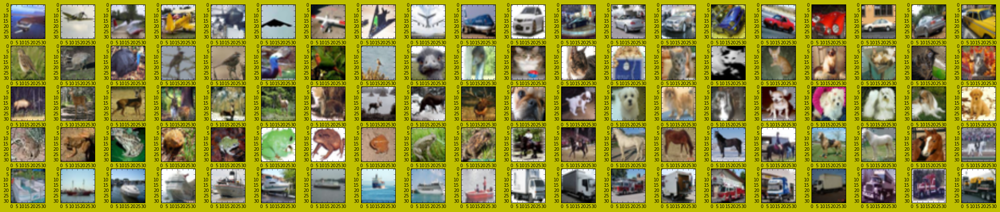

In [9]:
# Load the images using openCV
imageArr = [cv2.imread(img) for img in imagePath] 
# Note : Open CV reads an Image in BGR, so we have to convert it into RBG
imageArr = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in imageArr]
vizualize(imageArr,rows=5,columns=20)

In [7]:
# # Load the images using openCV
# imageArr = [cv2.imread(img) for img in imagePath] 
# # Note : Open CV reads an Image in BGR, so we have to convert it into RBG
# imageArr = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for num,img in enumerate(imageArr) if num in [4,26,45,73]]
# # vizualize(imageArr,rows=4,columns=20)
# vizualize(imageArr,rows=2,columns=2, figsize=(10,10))

## TensorFlow Image Preprocessing Operations:
------

In [10]:
def reset_graph():  # Reset the graph
    if 'sess' in globals() and sess:
        sess.close()
    tf.reset_default_graph()

(100, 32, 32, 3)
The shape of input image Tnsor is:  (100, 32, 32, 3)
100
{'distorted_image': <tf.Tensor 'div:0' shape=(32, 32, 3) dtype=float32>, 'imageIN': <tf.Tensor 'Placeholder:0' shape=(32, 32, 3) dtype=float32>}


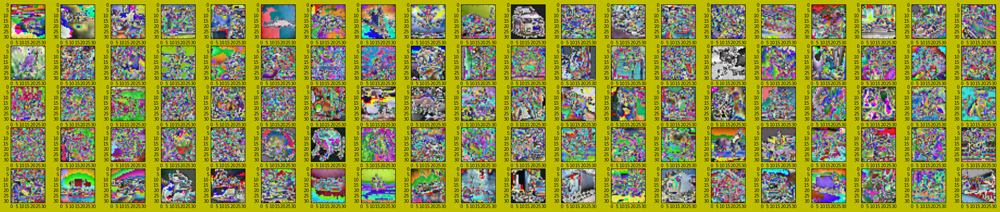

In [13]:
# Vizualizing Tensorflow operation

# Note Tensor flow takes input of 4 tensors, 
from scipy import misc
import tensorflow as tf

###############
imgTensor = np.ndarray(shape=(100,32,32,3), dtype='uint8')  # uint8 is defined for images: that takes on values between 0 and 255
print (imgTensor.shape)
for i,img in enumerate(imageArr):
    imgTensor[i,:] = img
    
print ('The shape of input image Tnsor is: ', imgTensor.shape)

# Now lets imagine the inputTensor is one batch of 80 images and we now do tensor flow image processing operation on it.
# def inputs(imgIN):
def imagePreprocessing(imageSize, numChannels):
    
    '''
        Normally the inputs have dtype unit8 (0-255), We however take the input as float32 because we perform 
        operations like brightness, contrast and whitening that doest arithmatic operation which many make the 
        pixels value as floating point.
    '''
    imageIN = tf.placeholder(tf.float32, [imageSize, imageSize, numChannels])
    
    # Crop a portion from the image
#     distorted_image = tf.random_crop(distorted_image, [32, 32, 3])       # Given an image this operation will make a random crop of the image given the crop size
    
    # Flip the image
    distorted_image = tf.image.random_flip_left_right(imageIN)   # Given an image this operation may or may not flip the image
    # Add random brightness
    distorted_image = tf.image.random_brightness(distorted_image,max_delta=63)
    # Add random contrast
    distorted_image = tf.image.random_contrast(distorted_image,lower=0.2, upper=1.8)
    # Standarize: # Subtract off the mean and divide by the variance of the pixels.:
    distorted_image = tf.image.per_image_standardization(distorted_image)
    
    return dict(imageIN=imageIN,
                 distorted_image=distorted_image)
#     return distorted_image



print (imgTensor.shape[0])
#     return distorted_image

reset_graph()
processGraphDict = imagePreprocessing(imageSize=32, numChannels=3)
print (processGraphDict)
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())

    trainPreprocessOUT = np.ndarray(shape=(100,32,32,3), dtype='float32')
    for numImage in np.arange(imgTensor.shape[0]):
        feed_dict = {processGraphDict['imageIN']:imgTensor[numImage,:]}
        im_distorted = sess.run(processGraphDict['distorted_image'],feed_dict=feed_dict)
#         print (im_distorted)
        trainPreprocessOUT[numImage,:] = im_distorted

# print (trainPreprocessOUT)
imgOut = []
for numimg in np.arange(trainPreprocessOUT.shape[0]):
#     print (trainPreprocessOUT[numimg,:])
    imgOut.append(trainPreprocessOUT[numimg,:])
    
vizualize(imgOut,rows=5,columns=20)


## OpenCV Image Preprocessing Opereations:
------

##### Flipped Image

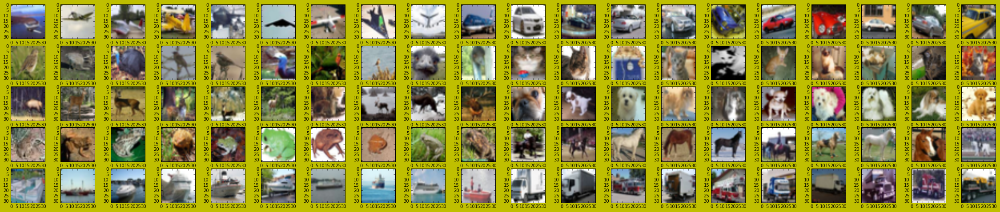

In [14]:
imgHFliped = [cv2.flip(img,1) for img in imageArr]
vizualize(imgHFliped, rows=5,columns=20)

##### GrayScale Image

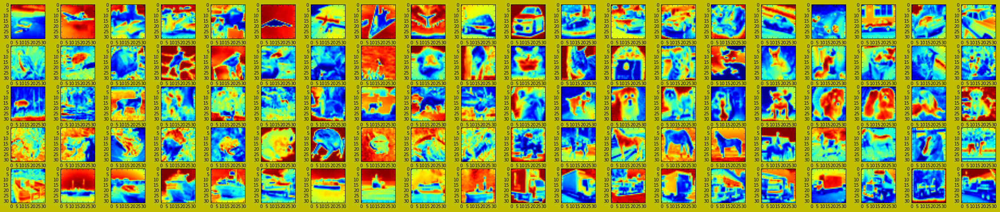

In [15]:
imageGray = [cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in imageArr] 
vizualize(imageGray,rows=5,columns=20)

##### GrayScale | Cropped | Image

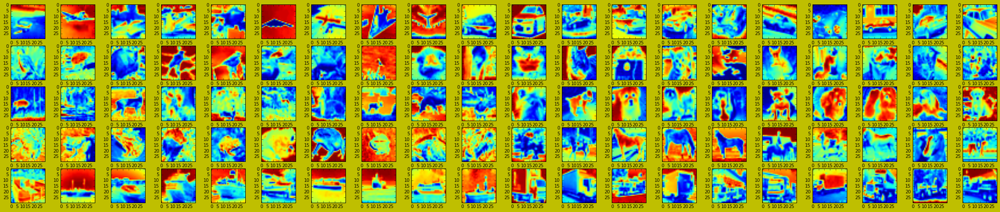

In [16]:
imageGrayCrop = [img[1:31, 1:31] for img in imageGray] 
vizualize(imageGrayCrop,rows=5,columns=20)

##### Blurr Image

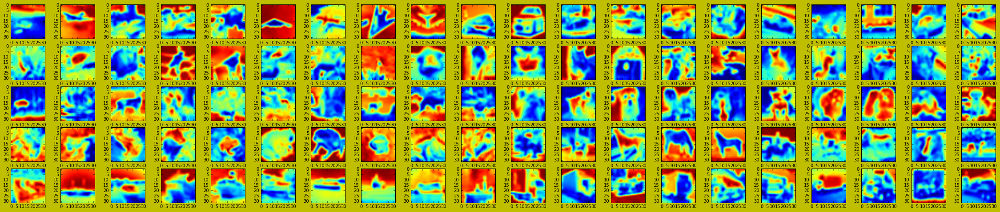

In [17]:
# Applyting Gaussian blurr blurr to the pictures
imageBlurr = [cv2.GaussianBlur(img, (3,3),3) for img in imageGray]
# A bigger value of sigma will result in better smooting. Since the image we are operating on is pretty small we would want to use a small kernel (filter) 
# and a small value of sigma
vizualize(imageBlurr,rows=5,columns=20)
# print (imageBlurr)

##### Laplace Edge

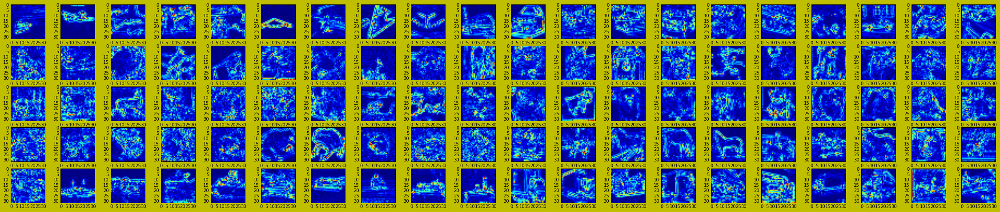

In [18]:
# Applying Edge detection Techniques, 1. Laplse Edge Detector.
imageLapEdge = [cv2.Laplacian(img, cv2.CV_64F) for img in imageGray]
imageLapEdge = np.uint8(np.absolute(imageLapEdge))
vizualize(imageLapEdge,rows=5,columns=20)

##### Sobel Edge

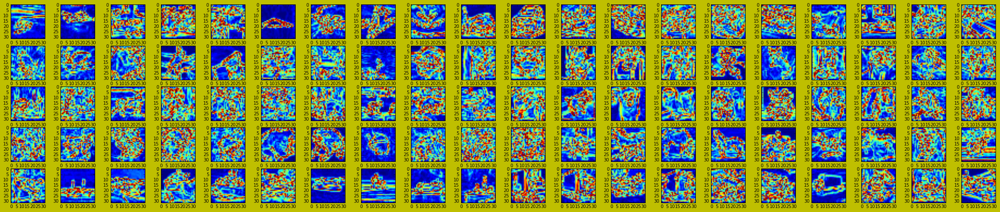

In [19]:
# Applying Edge detection Techniques, 1. Sobel Edge Detector.
# Now we shall use Sobel operator top determine the horizontal and vertical edges
def sobelEdge(img):
    sobelX= cv2.Sobel(img, cv2.CV_64F,1,0)
    sobelY= cv2.Sobel(img, cv2.CV_64F,0,1)
    sobelX = np.uint8(np.absolute(sobelX))#np.absolute(sobelX)
    sobelY = np.uint8(np.absolute(sobelY))#np.absolute(sobelY)
    sobelCombined = cv2.bitwise_or(sobelX, sobelY)
    return sobelCombined

imageSobEdge = [sobelEdge(img) for img in imageGray]
vizualize(imageSobEdge,rows=5,columns=20)

##### Canny Edge

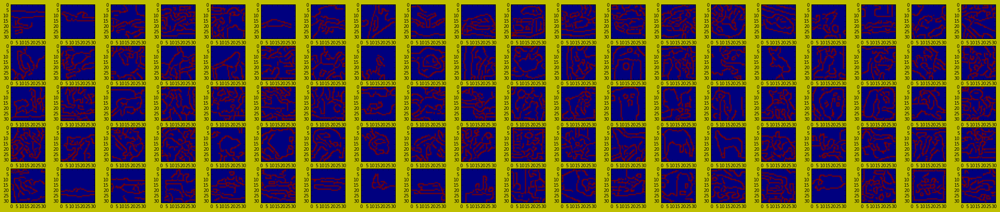

In [20]:
imageCannyEdge = [cv2.Canny(img, 30, 150) for img in imageBlurr]
vizualize(imageCannyEdge,rows=5,columns=20)

## HOG discreptor 
------
We also print the histograms to get a intuitive sense if the parameters we use makes sense or not.

In [22]:
from skimage.feature import hog

class HOG:
    def __init__(self, featureParams): 
        self.orienations = featureParams['orientations']
        self.pixelsPerCell = featureParams['pixelsPerCell']
        self.cellsPerBlock = featureParams['cellsPerBlock']
        self.block_norm = featureParams['block_norm']
        self.visualise = featureParams['visualise']
        self.transform_sqrt = featureParams['transform_sqrt']

    def describe(self, image):
        # Use transform_sqrt for Power law Compression before processing the image to increase the accuracy
        # Use visualise to return the image of the histogram
        if self.visualise:
            hist, hog_image = hog(image,
                                orientations = self.orienations,
                                pixels_per_cell = self.pixelsPerCell,
                                cells_per_block = self.cellsPerBlock,
                                visualise= self.visualise,
                                transform_sqrt = self.transform_sqrt)
            return hist, hog_image
        else:
            hog_image = hog(image,
                                orientations = self.orienations,
                                pixels_per_cell = self.pixelsPerCell,
                                cells_per_block = self.cellsPerBlock,
                                transform_sqrt = self.transform_sqrt)
            return hog_image



def hog_feature(featureParams,image_in):
#     print (featureParams)
    obj_HOG = HOG(featureParams)
    for no,img in enumerate(image_in):
        hist, hog_image = obj_HOG.describe(img)
        yield hog_image

In [22]:
# Vizualizing Tensorflow operation

# Note Tensor flow takes input of 4 tensors, 
from scipy import misc
import tensorflow as tf

###############
imgTensor = np.ndarray(shape=(100,32,32), dtype='uint8')  # uint8 is defined for images: that takes on values between 0 and 255
print (imgTensor.shape)
for i,img in enumerate(imageGray):
    imgTensor[i,:] = img
    
print ('The shape of input image Tnsor is: ', imgTensor.shape)




featureParams3_1 = dict(orientations = 9, pixelsPerCell = (2, 2), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = False, transform_sqrt = True)
featureParams3_2 = dict(orientations = 9, pixelsPerCell = (4, 4), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = False, transform_sqrt = True)
featureParams3_3 = dict(orientations = 9, pixelsPerCell = (6, 6), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = False, transform_sqrt = True)
featureParams3_4 = dict(orientations = 9, pixelsPerCell = (8, 8), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = False, transform_sqrt = True)

obj_HOG_p3_1 = HOG(featureParams3_1)
obj_HOG_p3_2 = HOG(featureParams3_2)
obj_HOG_p3_3 = HOG(featureParams3_3)
obj_HOG_p3_4 = HOG(featureParams3_4)

def pyfunction(inputIN):
    imgHOGp3_1 = obj_HOG_p3_1.describe(inputIN)             # We collect the HOG image pertaining to the first parameter settings
    imgHOGp3_2 = obj_HOG_p3_2.describe(inputIN)
    imgHOGp3_3 = obj_HOG_p3_3.describe(inputIN)
    imgHOGp3_4 = obj_HOG_p3_4.describe(inputIN)
    featureHOG = np.hstack((imgHOGp3_1,imgHOGp3_2,imgHOGp3_3,imgHOGp3_4)) 
    numFeatures = len(featureHOG)
    return np.array(featureHOG, dtype='float32').reshape(1,numFeatures)

class BuildNeuralNet():
    def __init__(self):
        self.numChannels =1
        self.imageSize = 32
        
    def imagePreprocessing(self):

        '''
            Normally the inputs have dtype unit8 (0-255), We however take the input as float32 because we perform 
            operations like brightness, contrast and whitening that doest arithmatic operation which many make the 
            pixels value as floating point.
        '''
        imageIN = tf.placeholder(tf.float32, [self.imageSize, self.imageSize, 1])
        # Flip the image
        distorted_image = tf.image.random_flip_left_right(imageIN)   # Given an image this operation may or may not flip the image

        distorted_image = tf.reshape(distorted_image, [self.imageSize, self.imageSize])

        featureHOG = tf.py_func(pyfunction, [distorted_image], tf.float32)

        return dict(imageIN=imageIN,
                     featureHOG=featureHOG)


class SessionExec():
    def __init__(self):
        self.imageSize = 32
        self.numChannels =1
        
    def execute(self, imgTensor):
        reset_graph()
        obj_NN = BuildNeuralNet()
        processGraphDict = obj_NN.imagePreprocessing()
        print (processGraphDict)
        
        with tf.Session() as sess:
            sess.run(tf.global_variables_initializer())

            trainPreprocessOUT = None #np.ndarray(shape=(80,32,32), dtype='float32')
            for numImage in np.arange(imgTensor.shape[0]):
        #         print ('running Image NUM: ', numImage)
                imageIN = imgTensor[numImage,:].reshape([imgTensor.shape[1], imgTensor.shape[2], 1])
#                 print (imageIN.shape)
                feed_dict = {processGraphDict['imageIN']:imageIN}   # reshaped to 32x32x1 as tensorflow operation asuums an image contai 3 Tensors 
                feature_hog = sess.run(processGraphDict['featureHOG'],feed_dict=feed_dict)
                if trainPreprocessOUT is None:
                    trainPreprocessOUT = feature_hog
                else:
                    trainPreprocessOUT = np.vstack((trainPreprocessOUT, feature_hog))
        return trainPreprocessOUT

    
trainPreprocessOUT = SessionExec().execute(imgTensor)
print (trainPreprocessOUT.shape)



(80, 32, 32)
The shape of input image Tnsor is:  (80, 32, 32)
{'imageIN': <tf.Tensor 'Placeholder:0' shape=(32, 32, 1) dtype=float32>, 'featureHOG': <tf.Tensor 'PyFunc:0' shape=<unknown> dtype=float32>}
(80, 3249)


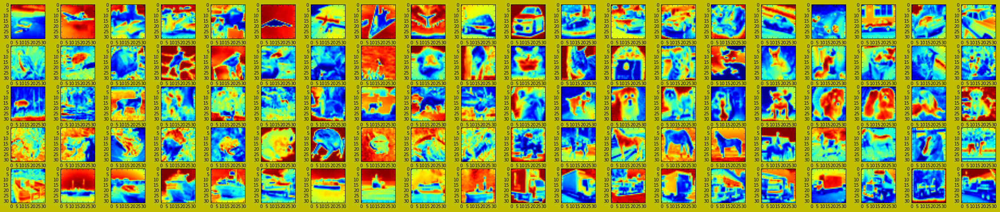

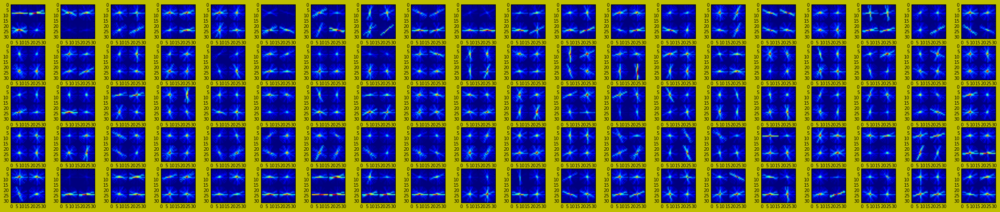

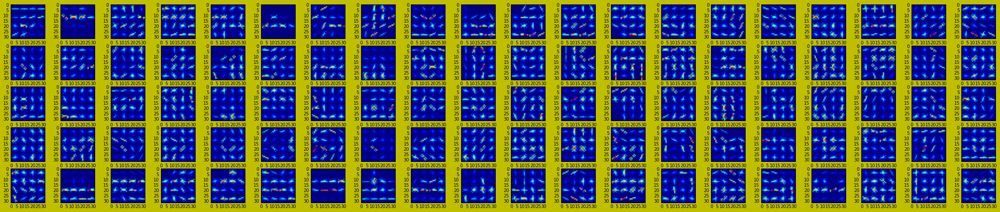

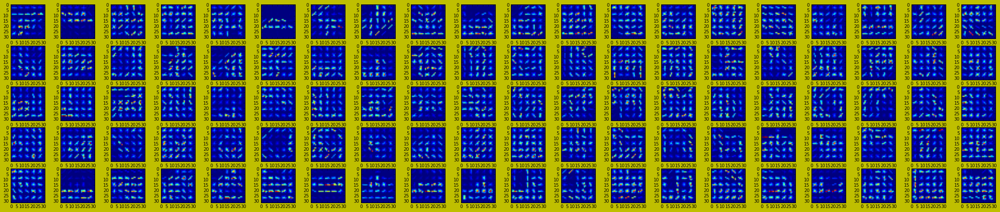

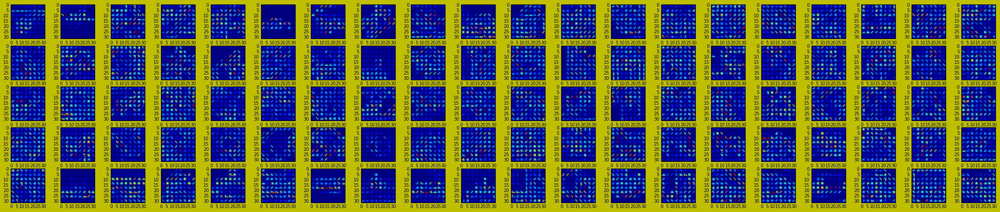

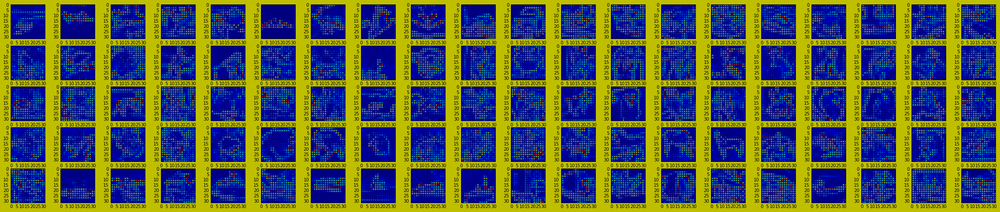

In [23]:
featureParams1 = dict(orientations = 18, pixelsPerCell = (16,16), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)
featureParams2 = dict(orientations = 18, pixelsPerCell = (8,8), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)
featureParams3 = dict(orientations = 18, pixelsPerCell = (6,6), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)
featureParams4 = dict(orientations = 18, pixelsPerCell = (4, 4), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)
featureParams5 = dict(orientations = 18, pixelsPerCell = (2, 2), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)

imageType = imageGray

hogImageArr1 = [output for output in hog_feature(featureParams1 ,imageType)]
hogImageArr2 = [output for output in hog_feature(featureParams2 ,imageType)]
hogImageArr3 = [output for output in hog_feature(featureParams3 ,imageType)]
hogImageArr4 = [output for output in hog_feature(featureParams4 ,imageType)]
hogImageArr5 = [output for output in hog_feature(featureParams5 ,imageType)]

vizualize(imageType,rows=5,columns=20)
vizualize(hogImageArr1,rows=5,columns=20)
vizualize(hogImageArr2,rows=5,columns=20)
vizualize(hogImageArr3,rows=5,columns=20)
vizualize(hogImageArr4,rows=5,columns=20)
vizualize(hogImageArr5,rows=5,columns=20)

##### HOG (Intermixing custom python code and Tensor flow operation)

(100, 32, 32)
The shape of input image Tnsor is:  (100, 32, 32)
{'imageIN': <tf.Tensor 'Placeholder:0' shape=(32, 32, 1) dtype=float32>, 'featureHOG': <tf.Tensor 'PyFunc:0' shape=<unknown> dtype=float32>}


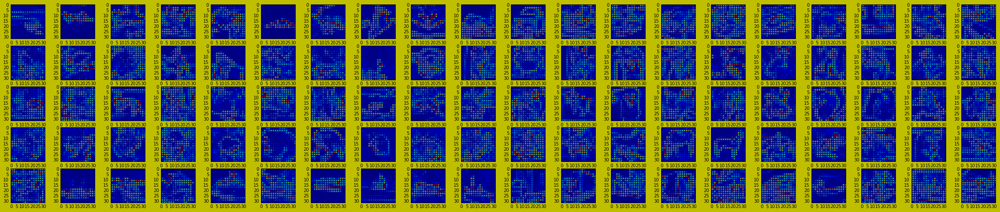

In [24]:
# Vizualizing Tensorflow operation

# Note Tensor flow takes input of 4 tensors, 
from scipy import misc
import tensorflow as tf

###############
imgTensor = np.ndarray(shape=(100,32,32), dtype='uint8')  # uint8 is defined for images: that takes on values between 0 and 255
print (imgTensor.shape)
for i,img in enumerate(imageGray):
    imgTensor[i,:] = img
    
print ('The shape of input image Tnsor is: ', imgTensor.shape)


featureParams3_1 = dict(orientations = 9, pixelsPerCell = (2, 2), cellsPerBlock = (1, 1), block_norm = 'L1', visualise = True, transform_sqrt = True)
obj_HOG_p3_1 = HOG(featureParams3_1)

def pyfunction(inputIN):
    hist1, imgHOGp3_1 = obj_HOG_p3_1.describe(inputIN)             # We collect the HOG image pertaining to the first parameter settings
    return np.array(imgHOGp3_1, dtype='float32')

class BuildNeuralNet():
    def __init__(self):
            pass

    def imagePreprocessing(self,imageSize, numChannels):

        '''
            Normally the inputs have dtype unit8 (0-255), We however take the input as float32 because we perform 
            operations like brightness, contrast and whitening that doest arithmatic operation which many make the 
            pixels value as floating point.
        '''
        imageIN = tf.placeholder(tf.float32, [imageSize, imageSize, numChannels])
        # Flip the image
        distorted_image = tf.image.random_flip_left_right(imageIN)   # Given an image this operation may or may not flip the image

        distorted_image = tf.reshape(distorted_image, [imageSize, imageSize])

        featureHOG = tf.py_func(pyfunction, [distorted_image], tf.float32)

        return dict(imageIN=imageIN,
                     featureHOG=featureHOG)

    
class SessionExec():
    
    def execute(self, imgTensor):
        reset_graph()
        obj_NN = BuildNeuralNet()
        processGraphDict = obj_NN.imagePreprocessing(imageSize=32, numChannels=1)
        print (processGraphDict)
        with tf.Session() as sess:
            sess.run(tf.global_variables_initializer())

            trainPreprocessOUT = []#np.ndarray(shape=(80,32,32), dtype='float32')
            for numImage in np.arange(imgTensor.shape[0]):
        #         print ('running Image NUM: ', numImage)
                feed_dict = {processGraphDict['imageIN']:imgTensor[numImage,:].reshape([imgTensor.shape[1], imgTensor.shape[2],1])}
                feature_hog = sess.run(processGraphDict['featureHOG'],feed_dict=feed_dict)
        #         print ('The HOG feature out is: ', feature_hog.shape)
        #         print (im_distorted)
                trainPreprocessOUT.append(feature_hog)
        #         trainPreprocessOUT[numImage,:] = feature_hog
        return trainPreprocessOUT

(trainPreprocessOUT) = SessionExec().execute(imgTensor) 
# len(trainPreprocessOUT)



# print (trainPreprocessOUT)
imgOut = []
for numimg in np.arange(len(trainPreprocessOUT)):
#     print (trainPreprocessOUT[numimg,:])
    imgOut.append(trainPreprocessOUT[numimg])
    
vizualize(imgOut,rows=5,columns=20)

## ZCA Whitening:
-----

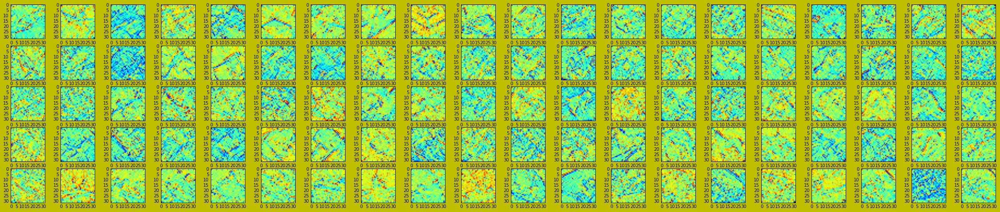

In [25]:
from __future__ import division
import numpy as np


def featureaMeanNorm(image):     
    return (image - np.mean(image, axis=0))  


def ZCA_whitening(img):
    epsilon =0.1
    img = featureaMeanNorm(img)
    sigma_mat = np.dot(img,np.transpose(img))/img.shape[1]
#     sigma_mat = np.cov(img, rowvar=True)
    U,S,_ = np.linalg.svd(sigma_mat)
    
    img_rot = np.dot(U.T, img)
    denominator = np.diag(1.0/np.sqrt(S+epsilon))
    PCA_whitening = np.dot(denominator, img_rot)
    
    ZCA_whitening = np.dot(U, PCA_whitening)
    return ZCA_whitening

imageZCA = [ZCA_whitening(img) for img in imageGray]
vizualize(imageZCA,rows=5,columns=20)